In [3]:
%run './model/multi_corpus.py'
%run './constants.py'

import polars as pl
import numpy as np

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE

from gensim.models.doc2vec import Doc2Vec, TaggedDocument

import umap.umap_ as umap

import torch
from torch_geometric.data import Data
from torch_geometric.nn import Node2Vec
from torch_geometric.utils.convert import to_networkx, from_networkx

import sklearn

import matplotlib.pyplot as plt
import seaborn as sns

# Co-Occurrence

In [4]:
corpora = co_occurence_graphs()
Gs = {field_name: corpus['G'] for (field_name, corpus) in corpora.items()}
Dfs = {field_name: corpus['Df'] for (field_name, corpus) in corpora.items()}

Gender Studies Graph with 19647 nodes and 2649106 edges
Geometry Graph with 12510 nodes and 1208185 edges
Geophysics Graph with 21402 nodes and 3699772 edges
Economics Graph with 12803 nodes and 1338707 edges
Language & Linguistics Graph with 15692 nodes and 2130610 edges
Probability & Statistics Graph with 15353 nodes and 2308625 edges
Material Engineering Graph with 21306 nodes and 3507415 edges
Artificial Intelligence Graph with 16142 nodes and 2795312 edges
Sociology Graph with 17143 nodes and 2474146 edges
International Business Graph with 13673 nodes and 1998495 edges
Political Science Graph with 16548 nodes and 2165657 edges
Genetics & Genomics Graph with 22262 nodes and 3450132 edges
Immunology Graph with 22793 nodes and 4144310 edges
Human Resources & Organizations Graph with 14713 nodes and 2277185 edges
Ethnic & Cultural Studies Graph with 16863 nodes and 2241634 edges
Neurology Graph with 20744 nodes and 3681821 edges


## Embeddings

In [10]:
embedding_dim = 128
walk_length = 20
context_size = 10
walks_per_node = 10

epochs = 10
train_size = 0.70

device = 'cuda' if torch.cuda.is_available() else 'cpu'

embs_dict = {}

for (field_name, G) in Gs.items():

    pyg_citation = from_networkx(G)

    nodes = pyg_citation.edge_index.numpy()
    nodes = np.unique(list(nodes[0]) + list(nodes[1]))

    train_set, test_val_set = sklearn.model_selection.train_test_split(nodes, train_size=train_size, random_state=1)
    test_set, val_set = sklearn.model_selection.train_test_split(test_val_set, train_size=0.5, random_state=1)

    train_mask = torch.zeros(len(nodes), dtype=torch.long, device=device)
    for i in train_set:
        train_mask[i] = 1.

    test_mask = torch.zeros(len(nodes), dtype=torch.long, device=device)
    for i in test_set:
        test_mask[i] = 1.
        
    val_mask = torch.zeros(len(nodes), dtype=torch.long, device=device)
    for i in val_set:
        val_mask[i] = 1.

    pyg_citation.train_mask = train_mask
    pyg_citation.test_mask = test_mask
    pyg_citation.val_mask = val_mask

    node_model = Node2Vec(
        pyg_citation.edge_index,
        embedding_dim=embedding_dim,
        walk_length=walk_length,
        context_size=context_size,
        walks_per_node=walks_per_node,
        num_negative_samples=1,
        p=1,
        q=1,
        sparse=True
    ).to(device)

    loader = node_model.loader(batch_size=128, shuffle=True, num_workers=4)
    optimizer = torch.optim.SparseAdam(list(node_model.parameters()), lr=0.01)

    for epoch in range(epochs):

        node_model.train()
        total_loss = 0
        for pos_rw, neg_rw in loader:
            optimizer.zero_grad()
            loss = node_model.loss(pos_rw.to(device), neg_rw.to(device))
            loss.backward()
            optimizer.step()
            total_loss += loss.item()
        loss = total_loss / len(loader)
        
        if epoch == epochs-1:
            print(f'{field_name}: {loss:.4f}')

    node_model = node_model()
    embs = node_model.detach().cpu().numpy()

    embs_dict[field_name] = embs

# 180 min

Gender Studies
Gender Studies: 1.0402
Geometry
Geometry: 1.0493
Geophysics
Geophysics: 1.0395
Economics
Economics: 1.0519
Language & Linguistics
Language & Linguistics: 1.0446
Probability & Statistics
Probability & Statistics: 1.0514
Material Engineering
Material Engineering: 1.0415
Artificial Intelligence
Artificial Intelligence: 1.0478
Sociology
Sociology: 1.0361
International Business
International Business: 1.0520
Political Science
Political Science: 1.0349
Genetics & Genomics
Genetics & Genomics: 1.0447
Immunology
Immunology: 1.0493
Human Resources & Organizations
Human Resources & Organizations: 1.0506
Ethnic & Cultural Studies
Ethnic & Cultural Studies: 1.0398
Neurology
Neurology: 1.0457


## PCA (Node Embedding)

Gender Studies
Geometry
Geophysics
Economics
Language & Linguistics
Probability & Statistics
Material Engineering
Artificial Intelligence
Sociology
International Business
Political Science
Genetics & Genomics
Immunology
Human Resources & Organizations
Ethnic & Cultural Studies
Neurology


[]

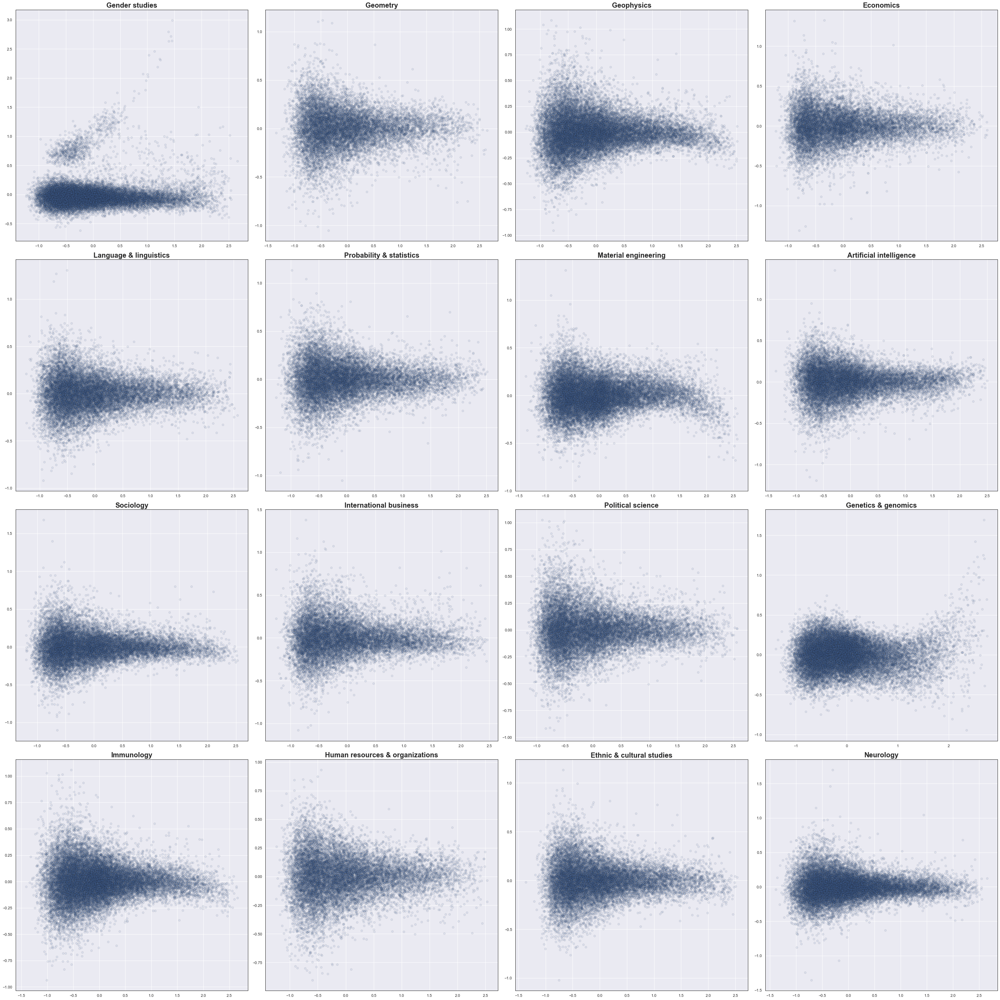

In [11]:
sns.set()
n_cols = 4
width = 10
height = 10
n_rows = np.ceil(len(Gs) / n_cols)

fig, axs = plt.subplots(int(n_rows), int(n_cols), figsize=(n_cols*height, n_rows*width))
for (field_name, vecs), ax in zip(embs_dict.items(), axs.flatten()):

    print(field_name)
    
    embs = PCA(
        n_components=2, 
        random_state=42
    ).fit_transform(vecs)

    ax.scatter(embs[:, 0], embs[:, 1], alpha=.1, edgecolor='k')
    ax.set_title(f'{field_name.capitalize()}', fontweight='semibold', fontsize=20)
    
    ax.spines['top'].set_color('k')
    ax.spines['top'].set_linewidth(1)
    ax.spines['bottom'].set_color('k')
    ax.spines['bottom'].set_linewidth(1)
    ax.spines['right'].set_color('k')
    ax.spines['right'].set_linewidth(1)
    ax.spines['left'].set_color('k')
    ax.spines['left'].set_linewidth(1)

fig.tight_layout()
plt.savefig(f'{OBSIDIAN_IMG_PATH}/co_occurence_pca_node2vec.png')
plt.plot()


## tSNE (Node Embeddings)

Gender Studies
Geometry
Geophysics
Economics
Language & Linguistics
Probability & Statistics
Material Engineering
Artificial Intelligence
Sociology
International Business
Political Science
Genetics & Genomics
Immunology
Human Resources & Organizations
Ethnic & Cultural Studies
Neurology


[]

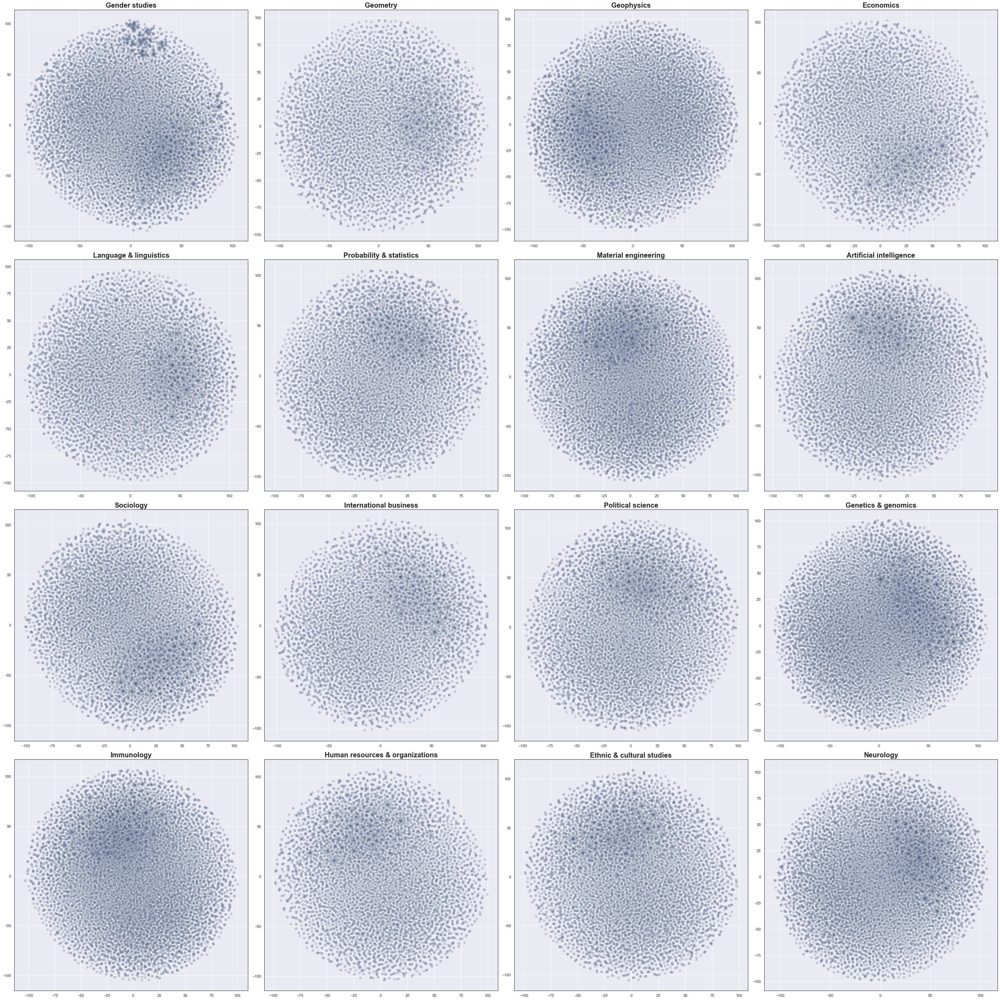

In [12]:
sns.set()
n_cols = 4
width = 10
height = 10
n_rows = np.ceil(len(Gs) / n_cols)

fig, axs = plt.subplots(int(n_rows), int(n_cols), figsize=(n_cols*height, n_rows*width))
for (field_name, vecs), ax in zip(embs_dict.items(), axs.flatten()):

    print(field_name)

    embs = TSNE(
        n_components=2, 
        random_state=1, 
        # n_iter=1000,
        metric='cosine',
        learning_rate='auto', 
        init='random', 
        perplexity=3
    ).fit_transform(vecs)

    ax.scatter(embs[:, 0], embs[:, 1], alpha=.1, edgecolor='k')

    ax.set_title(f'{field_name.capitalize()}', fontweight='semibold', fontsize=20)
    
    ax.spines['top'].set_color('k')
    ax.spines['top'].set_linewidth(1)
    ax.spines['bottom'].set_color('k')
    ax.spines['bottom'].set_linewidth(1)
    ax.spines['right'].set_color('k')
    ax.spines['right'].set_linewidth(1)
    ax.spines['left'].set_color('k')
    ax.spines['left'].set_linewidth(1)

fig.tight_layout()
plt.savefig(f'{OBSIDIAN_IMG_PATH}/co_occurence_tsne_node2vec.png')
plt.plot()

# UMAP (Node Embeddings)

Gender Studies
Geometry
Geophysics
Economics
Language & Linguistics
Probability & Statistics
Material Engineering
Artificial Intelligence
Sociology
International Business
Political Science
Genetics & Genomics
Immunology
Human Resources & Organizations
Ethnic & Cultural Studies
Neurology


[]

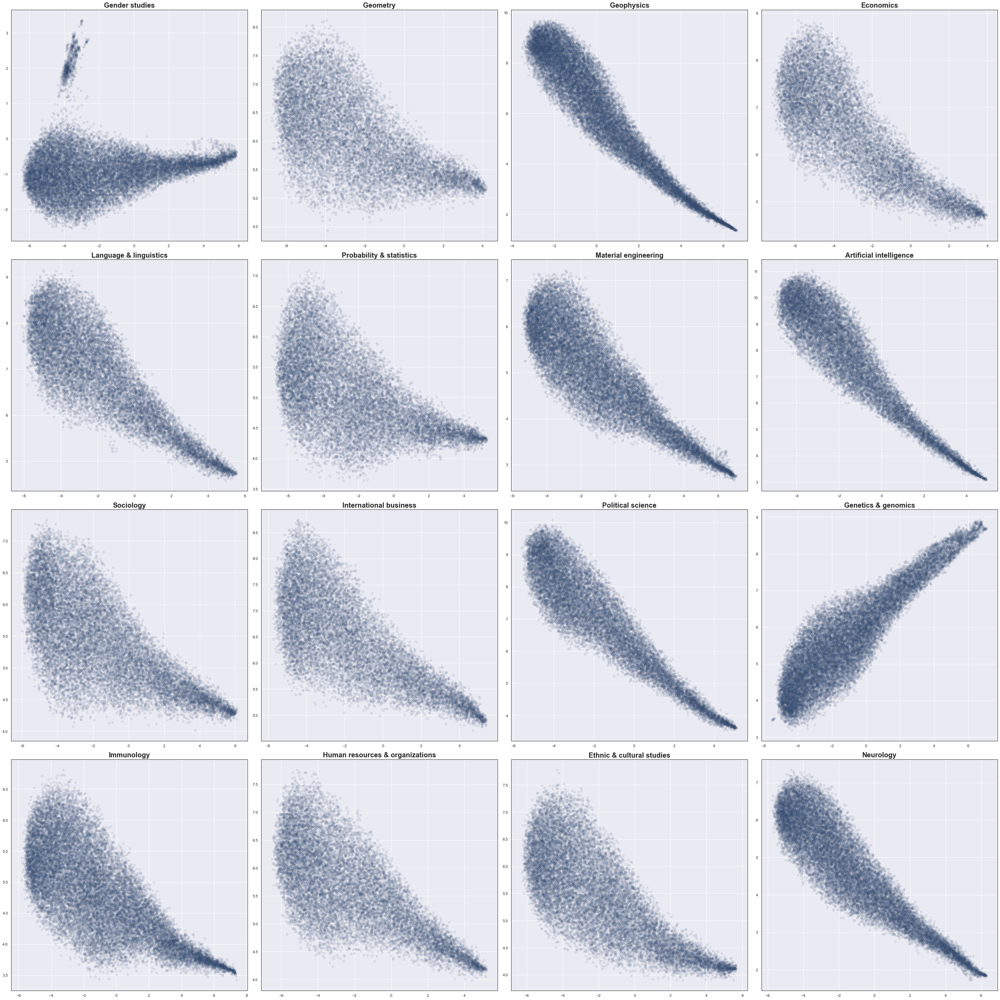

In [13]:
sns.set()
n_cols = 4
width = 10
height = 10
n_rows = np.ceil(len(Gs) / n_cols)

fig, axs = plt.subplots(int(n_rows), int(n_cols), figsize=(n_cols*height, n_rows*width))
for (field_name, vecs), ax in zip(embs_dict.items(), axs.flatten()):

    print(field_name)
    
    reducer = umap.UMAP(random_state=42)
    embs = reducer.fit_transform(vecs)

    ax.scatter(embs[:, 0], embs[:, 1], alpha=.1, edgecolor='k')
    
    ax.set_title(f'{field_name.capitalize()}', fontweight='semibold', fontsize=20)
    
    ax.spines['top'].set_color('k')
    ax.spines['top'].set_linewidth(1)
    ax.spines['bottom'].set_color('k')
    ax.spines['bottom'].set_linewidth(1)
    ax.spines['right'].set_color('k')
    ax.spines['right'].set_linewidth(1)
    ax.spines['left'].set_color('k')
    ax.spines['left'].set_linewidth(1)

fig.tight_layout()
plt.savefig(f'{OBSIDIAN_IMG_PATH}/co_occurence_umap_node2vec.png')
plt.plot()